In [1]:
import sys
from pathlib import Path

In [2]:
import cv2
from IPython.display import Image, display
from PIL import Image as Image2

In [3]:
yolov3_path = Path("C:/Users/yw46/OneDrive/デスクトップ/AiProject/YOLO/pytorch_yolov3")

In [4]:
sys.path.append(str(yolov3_path))
from yolov3.detector import Detector

In [5]:
config_path = yolov3_path / "config/yolov3_coco.yaml"
weights_path = yolov3_path / "weights/yolov3.weights"

In [6]:
def imshow(img):
    ret, encoded = cv2.imencode(".jpg", img)
    display(Image(encoded))

In [7]:
detector = Detector(config_path, weights_path)

Darknet format weights file loaded. C:\Users\yw46\OneDrive\デスクトップ\AiProject\YOLO\pytorch_yolov3\weights\yolov3.weights


In [8]:
import glob
file_path = "Image/"
files = glob.glob(file_path + '/*')
print(files)
print(len(files))

['Image\\sparrow_0.jpg', 'Image\\sparrow_1.jpg', 'Image\\sparrow_10.jpg', 'Image\\sparrow_100.jpg', 'Image\\sparrow_1000.jpg', 'Image\\sparrow_1001.jpg', 'Image\\sparrow_1002.jpg', 'Image\\sparrow_1003.jpg', 'Image\\sparrow_1004.jpg', 'Image\\sparrow_1005.jpg', 'Image\\sparrow_1006.jpg', 'Image\\sparrow_1007.jpg', 'Image\\sparrow_1008.jpg', 'Image\\sparrow_1009.jpg', 'Image\\sparrow_101.jpg', 'Image\\sparrow_1010.jpg', 'Image\\sparrow_1011.jpg', 'Image\\sparrow_1012.jpg', 'Image\\sparrow_1013.jpg', 'Image\\sparrow_1014.jpg', 'Image\\sparrow_1015.jpg', 'Image\\sparrow_1016.jpg', 'Image\\sparrow_1017.jpg', 'Image\\sparrow_1018.jpg', 'Image\\sparrow_1019.jpg', 'Image\\sparrow_102.jpg', 'Image\\sparrow_1020.jpg', 'Image\\sparrow_1021.jpg', 'Image\\sparrow_1022.jpg', 'Image\\sparrow_1023.jpg', 'Image\\sparrow_1024.jpg', 'Image\\sparrow_1025.jpg', 'Image\\sparrow_1026.jpg', 'Image\\sparrow_1027.jpg', 'Image\\sparrow_1028.jpg', 'Image\\sparrow_1029.jpg', 'Image\\sparrow_103.jpg', 'Image\\spar

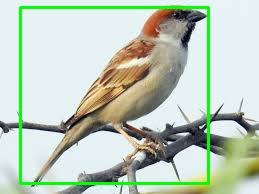

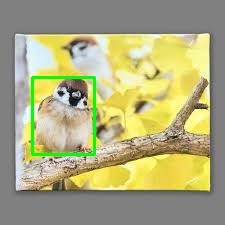

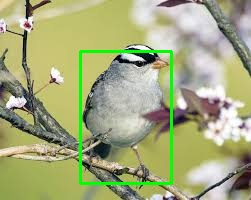

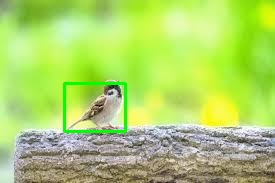

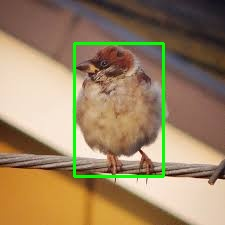

...

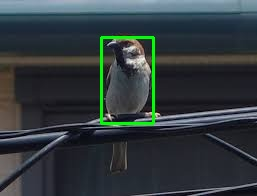

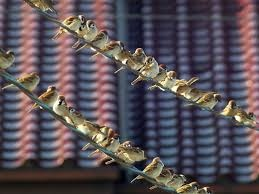

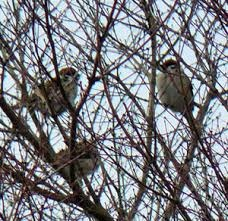

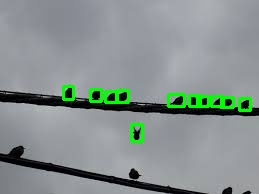

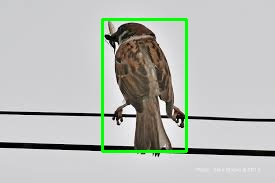

In [9]:
for i in range(0, 1552):
    img = cv2.imread(files[i])
    detections = detector.detect(img)
    bird = list(filter(lambda x: x["class_name"] == "bird", detections[0]))
    for bbox in bird:
        cv2.rectangle(
        img,
        (int(bbox["x1"]), int(bbox["y1"])),
        (int(bbox["x2"]), int(bbox["y2"])),
        color = (0, 255, 0),
        thickness = 2,
        )
    imshow(img)
    im = Image2.open(files[i])
    X=(int(bbox["x2"]) - int(bbox["x1"]))
    Y=(int(bbox["y2"]) - int(bbox["y1"]))
    if(Y>X):
        newX1=(int(bbox["x1"]) - ((Y - X)/2))
        newX2=int(bbox["x2"]) + ((Y - X)/2)
        im3=im.crop((newX1 - 30, int(bbox["y1"]) - 30) + (newX2 + 30, int(bbox["y2"]) + 30))
    else:
        newY1=int(bbox["y1"]) - ((X - Y)/2)
        newY2=int(bbox["y2"]) + ((X - Y)/2)
        im3=im.crop((int(bbox["x1"]) - 30, newY1 - 30) + (int(bbox["x2"]) + 30, newY2 + 30))
    im3.save("C:/Users/yw46/OneDrive/デスクトップ/AiProject/Script/NewCroped/sparrow" + str(i+1) + ".jpg")